In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
import normflows as nf
import matplotlib.pyplot as plt
import torch
import numpy as np
from torch.optim import Adam
from torch.utils.data import TensorDataset, DataLoader
from fab import FABModel, HamiltonianMonteCarlo, Metropolis
from fab.utils.logging import ListLogger
from fab.utils.plotting import plot_history, plot_contours, plot_marginal_pair
from fab.target_distributions.gmm import GMM
from fab.utils.prioritised_replay_buffer import SimpleBuffer
from torch.autograd import grad
from fab.utils.plotting import plot_contours, plot_marginal_pair
from experiments.make_flow import make_wrapped_normflow_realnvp
import models.ddpm
import models.mlp
import pdb
from tqdm import tqdm
from models.ddpm import GaussianDiffusion, TMLP
from models.mlp import MyMLP6dim, SpectralNormMLP

import torch
import torchsde

from functorch import vmap

from torchdiffeq import odeint

In [3]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(device)

cuda


### Target Distribution

In [27]:
from fab.target_distributions.many_well import ManyWellEnergy

dim = 32 # Can increase in to higher values that are multiples of two.
seed = 0
target = ManyWellEnergy(dim, a=-0.5, b=-6, use_gpu=True)

ManyWellEnergy()

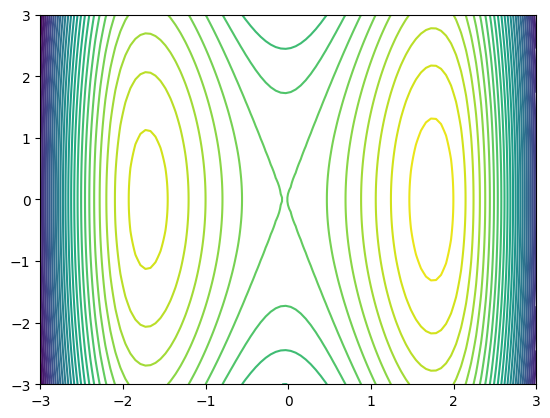

In [28]:
# plot the contours for the marginal distribution of the first 2D of target (i.e. the Double Well Problem).
target.to("cpu")
fig, ax = plt.subplots()
plotting_bounds = (-3, 3)
plot_contours(target.log_prob_2D, bounds=plotting_bounds, n_contour_levels=40, ax=ax, grid_width_n_points=100)
target.to(device)

### Helper Functions

In [29]:
def plot_dataset(samples, gen_samples=None, dim=dim):
    target.to("cpu")
    n_rows = dim // 2
    fig, axs = plt.subplots(dim // 2, 2,  sharex=True, sharey=True, figsize=(10, n_rows*3))

    for i in range(n_rows):
        plot_contours(target.log_prob_2D, bounds=plotting_bounds, ax=axs[i, 0], n_contour_levels=40)

        # plot flow samples
        plot_marginal_pair(samples, ax=axs[i, 0], bounds=plotting_bounds, marginal_dims=(i*2,i*2+1))
        axs[i, 0].set_xlabel(f"dim {i*2}")
        axs[i, 0].set_ylabel(f"dim {i*2 + 1}")


        if gen_samples is not None:
            plot_contours(target.log_prob_2D, bounds=plotting_bounds, ax=axs[i, 1], 
                        n_contour_levels=40)
            # plot generated samples
            plot_marginal_pair(gen_samples, ax=axs[i, 1], bounds=plotting_bounds, marginal_dims=(i*2,i*2+1))
            axs[i, 1].set_xlabel(f"dim {i*2}")
            axs[i, 1].set_ylabel(f"dim {i*2 + 1}")
        else:
            #delete subplot
            fig.delaxes(axs[i, 1])
        plt.tight_layout()
    
    axs[0, 0].set_title("Dataset")
    axs[0, 1].set_title("Generated samples")
    plt.show()
    return [fig]

In [30]:
def normalize(x):
    '''
        normalizes to [-1, 1]
    '''
    mins = -3 #torch.min(x, dim=0)[0]
    maxs = 3 #torch.max(x, dim=0)[0]
    ## [ 0, 1 ]
    x = (x - mins) / (maxs - mins + 1e-5)
    ## [ -1, 1 ]
    x = x * 2 - 1
    
    return x, mins, maxs

def unnormalize(x, mins, maxs):
    '''
        x : [ -1, 1 ]
    '''
    # assert x.max() <= 1 and x.min() >= -1, f'x range: ({x.min():.4f}, {x.max():.4f})'
    #x = x * std + mean
    x = (x + 1) / 2
    return x * (maxs - mins) + mins

## Function Definitions

### Estimated Reward Functions

In [31]:
# calculate the log expectation of the reward
def log_E_R(_x, _t, beta, num_mc_samples, global_mins=-3, global_maxs=3, var_exploding=True):
    h_t = beta * _t.repeat_interleave(num_mc_samples).unsqueeze(1)
    repeated_x = _x.unsqueeze(0).repeat_interleave(num_mc_samples, dim=0)
    repeated_t = _t.unsqueeze(0).repeat_interleave(num_mc_samples, dim=0)
    h_t  = beta * repeated_t
    h_t = h_t.unsqueeze(1)
    if var_exploding:
        # variance exploding
        samples = repeated_x + torch.randn(repeated_x.shape).to(device) * (h_t ** 0.5)
        log_rewards = target.log_prob(unnormalize(samples, global_mins, global_maxs))
        log_expectation_R = torch.logsumexp(log_rewards, dim=-1) - np.log(num_mc_samples)
    else:
        # variance preserving
        samples = repeated_x/torch.sqrt(1 - repeated_t.unsqueeze(1)) + torch.randn(repeated_x.shape).to(device) * (h_t ** 0.5)
        log_rewards = target.log_prob(unnormalize(samples, global_mins, global_maxs))
        log_expectation_R = torch.log(1 / (1 - _t)) + torch.logsumexp(log_rewards, dim=-1) - np.log(num_mc_samples)
    return log_expectation_R

In [32]:
def estimated_Rt(x, t, beta, num_mc_samples=100, var_exploding=True):
    if t.dim() == 0:
        # repeat the same time for all points if we have a scalar time
        t = t * torch.ones(x.shape[0]).to(device)
    return torch.vmap(log_E_R, 
                      randomness='different', in_dims=(0,0,None,None))(x, t, beta, num_mc_samples, var_exploding=var_exploding)

In [33]:
def estimate_grad_Rt(x, t, beta, num_mc_samples=100, var_exploding=True, richardson=False):
    est_scores_n = torch.vmap(torch.func.grad(log_E_R), 
                            in_dims=(0,0,None,None), randomness='different')(x, t, beta, num_mc_samples, 
                                                                                  var_exploding=var_exploding)
    if richardson:
        est_scores_n_div2 = torch.vmap(torch.func.grad(log_E_R), 
                                   in_dims=(0,0,None,None), randomness='different')(x, t, beta, num_mc_samples//2, 
                                                                                         var_exploding=var_exploding)
        return (2*est_scores_n - est_scores_n_div2)
    else:
        return est_scores_n

### True Reward Functions

In [34]:
def true_Rt(x, t, beta, global_mins=-3, global_maxs=3, var_exploding=True):
    h_t = beta * t
    target.convolve(h_t * (global_maxs **2), t, var_exploding=var_exploding)
    energy = target.log_prob(unnormalize(x, global_mins, global_maxs))
    target.reset()
    return energy

In [35]:
def true_grad_Rt(x, t, beta, var_exploding=True):
    samples_energy = true_Rt(x, t, beta, var_exploding=var_exploding)
    true_scores = torch.autograd.grad(samples_energy.sum(), x, retain_graph=True)[0].detach()
    return true_scores

## SDE Tests

### Dataset

In [36]:
# hyper-parameters

# Flow
n_flow_layers = 15
layer_nodes_per_dim = 40
lr = 1e-4
max_gradient_norm = 100.0
batch_size = 128
n_iterations = 4000
n_eval = 10
eval_batch_size = batch_size * 10
n_plots = 10 # number of plots shows throughout tranining
use_64_bit = True
alpha = 2.0
num_samples = 10000

flow = make_wrapped_normflow_realnvp(dim, n_flow_layers=n_flow_layers, 
                                 layer_nodes_per_dim=layer_nodes_per_dim,
                                act_norm = False)

In [37]:
# normalize the dataset
init_num_samples = 256
unnorm_true_samples = target.sample(torch.tensor(init_num_samples).unsqueeze(0)).to(device).detach()
unnorm_init_samples = flow.sample((init_num_samples,)).to(device).detach()
init_energy = target.log_prob(unnorm_init_samples).detach()
init_samples, global_mins_init, global_maxs_init = normalize(unnorm_init_samples)

global_mins_init = -3
global_maxs_init = 3

init_dataset = TensorDataset(init_samples, init_energy)
init_loader = DataLoader(init_dataset, batch_size = 512, shuffle=True) 

In [47]:
def euler_maruyama_step(sde, x, t, dt):
    # Calculate drift and diffusion terms
    drift = sde.f(t, x) * dt
    diffusion = sde.g(t, x) * np.sqrt(dt) * torch.randn_like(x).to(device)

    # Update the state
    x_next = x + drift + diffusion
    return x_next, drift

def integrate_sde(sde, x0, t_span, dt):
    times = torch.arange(t_span[0], t_span[1], dt).to(device)
    x = x0
    x0.requires_grad = True
    pred_v = []
    true_v = []
    samples = []
    with torch.no_grad():
        for t in times:
            x, f = euler_maruyama_step(sde, x, t, dt)
            samples.append(x)
            pred_v.append(f)
            # true_v.append(true_grad_Rt(x, 1-t, beta))
    return torch.stack(samples), torch.stack(pred_v) # , torch.stack(true_v)

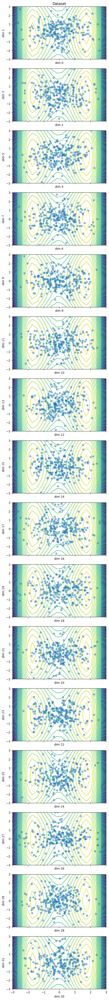

In [38]:
plot_dataset(unnorm_init_samples) # visualise the initial samples
plt.show()

### VE SDE

In [39]:
class VEReverseSDE(torch.nn.Module):
    noise_type = 'diagonal'
    sde_type = 'ito'
    
    def __init__(self, score, beta):
        super().__init__()
        self.score = score
        self.beta = beta
    
    def f(self, t, x):
        with torch.enable_grad():
            if t.dim() == 0:
                # repeat the same time for all points if we have a scalar time
                t = t * torch.ones(x.shape[0]).to(device)

            x.requires_grad = True
            score = self.score(x, 1-t, self.beta)
        return self.g(t, x)**2 * score 
    
    def g(self, t, x):
        return torch.full_like(x, self.beta ** 0.5)

In [40]:
def generate_samples(ve_reverse_sde, x_init):
    t = torch.linspace(0.001, 1.0, 500).to(device)
    with torch.no_grad():
        samples = torchsde.sdeint(ve_reverse_sde, x_init, t)
    return samples

In [48]:
# ve_reverse_sde = VEReverseSDE(true_grad_Rt, beta)
ve_reverse_sde = VEReverseSDE(estimate_grad_Rt, 1.1)
# samples = generate_samples(ve_reverse_sde, init_samples)
samples, pred_vectors = integrate_sde(ve_reverse_sde, init_samples, [0, 1], 0.001) #true_vectors

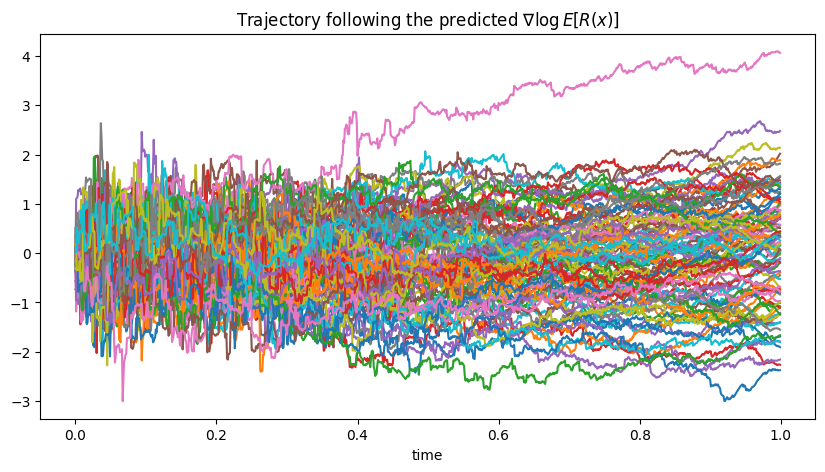

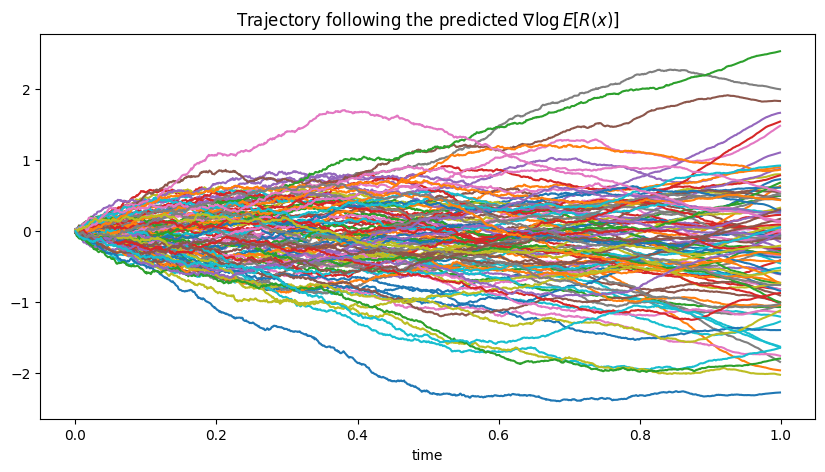

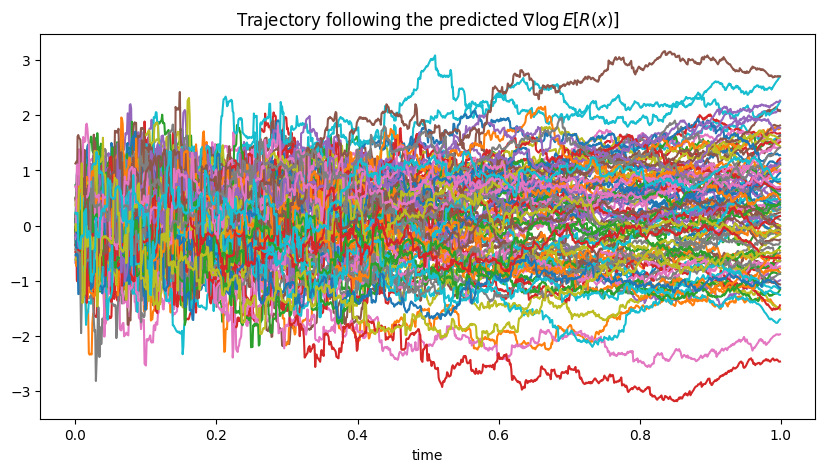

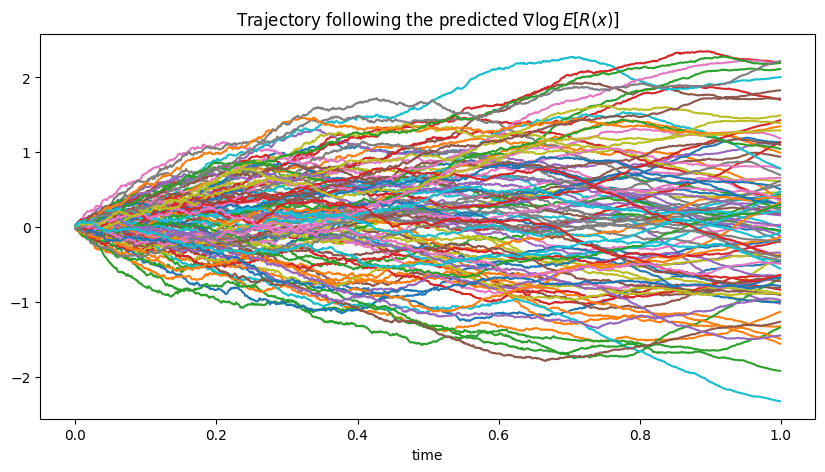

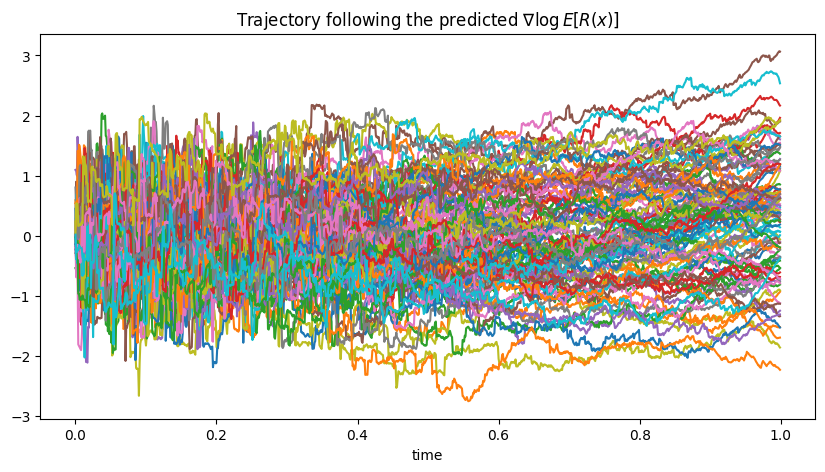

...

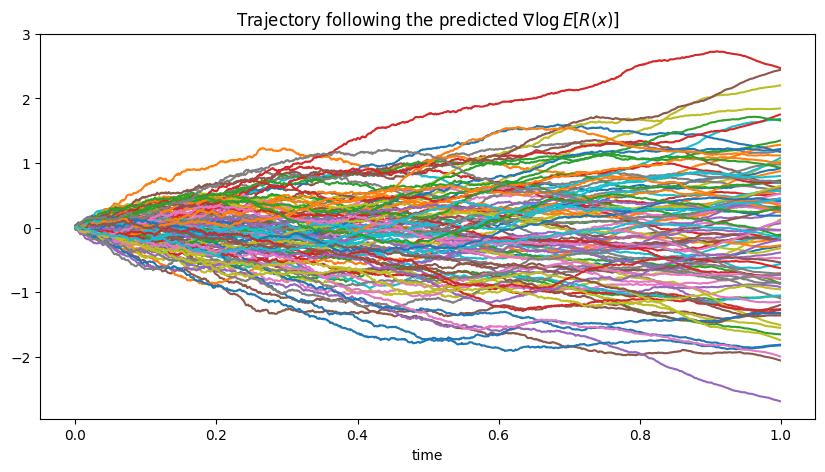

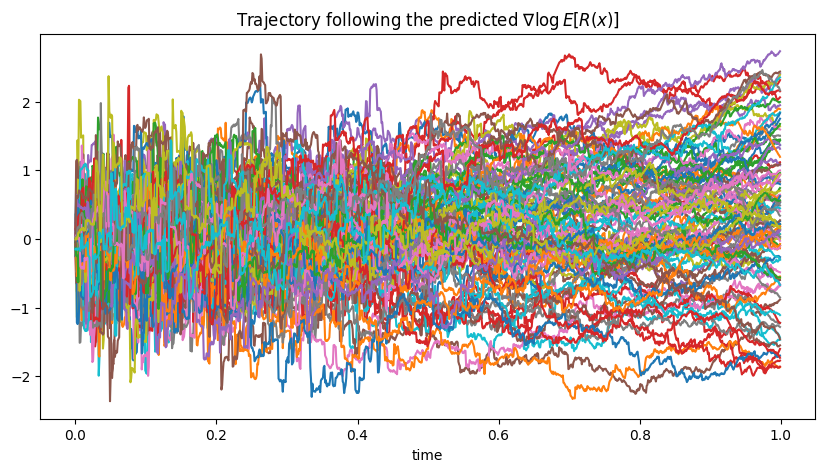

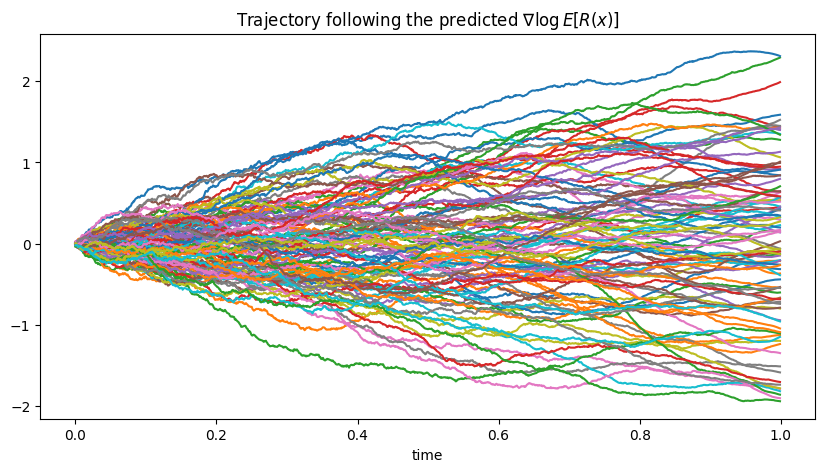

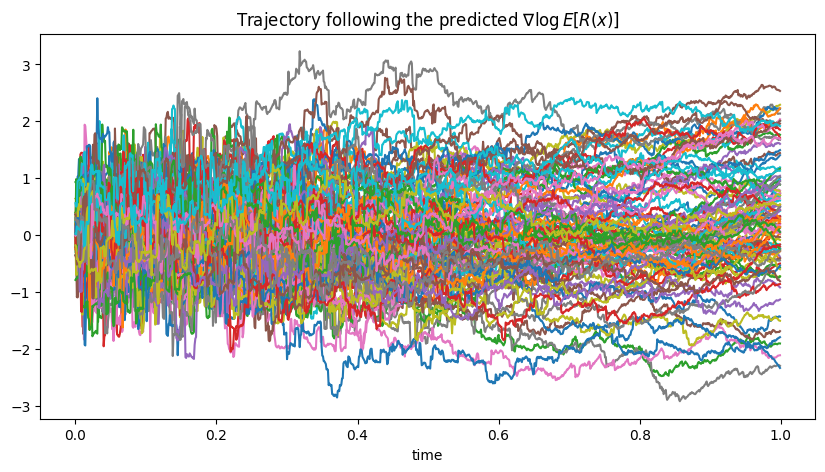

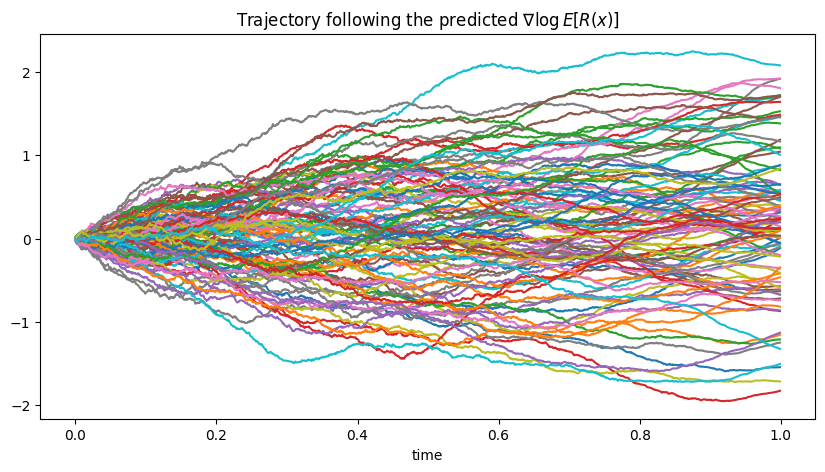

In [54]:
# predicted 

for i in range(dim):
    fig = plt.figure(figsize=(10, 5))
    # plt.plot(torch.arange(0, 1, 0.001), torch.cumsum(traj_norm_pred, dim=0).cpu())
    plt.plot(torch.arange(0, 1, 0.001), torch.cumsum(pred_vectors[:, :100, i], dim=0).cpu())
    plt.xlabel("time")
    plt.title(r"Trajectory following the predicted $\nabla \log E[R(x)]$")
    plt.show()


In [49]:
samples.shape

torch.Size([1000, 256, 32])

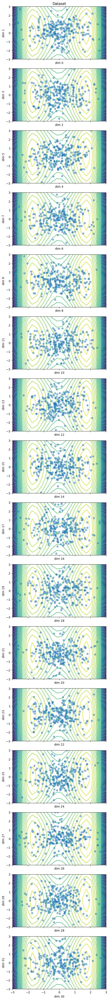

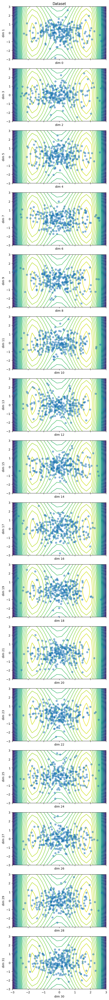

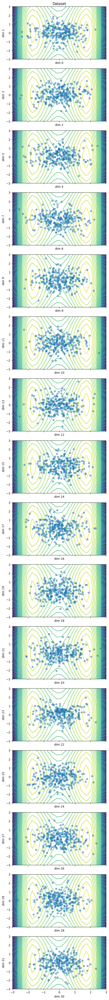

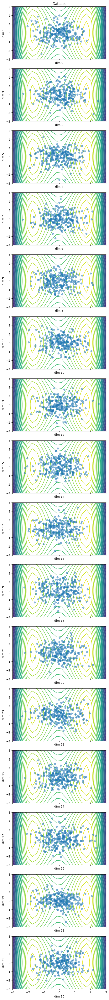

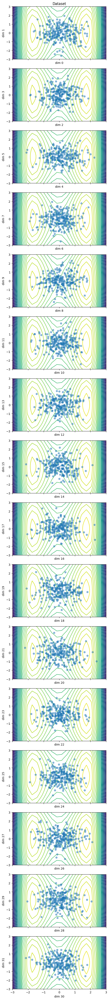

...

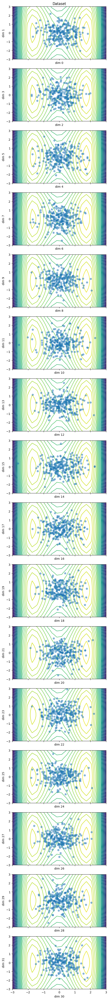

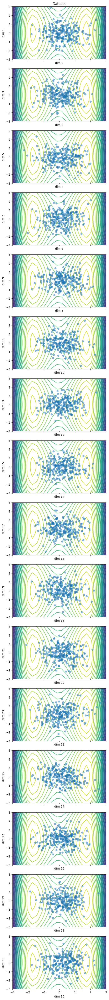

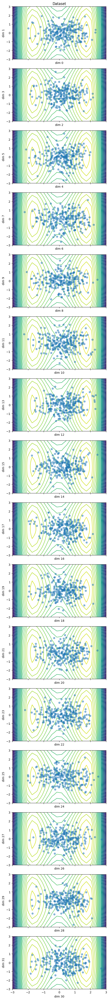

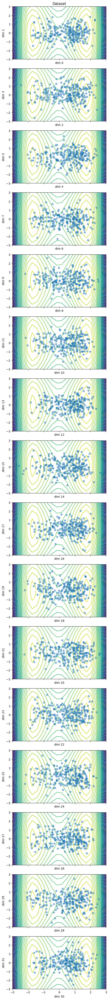

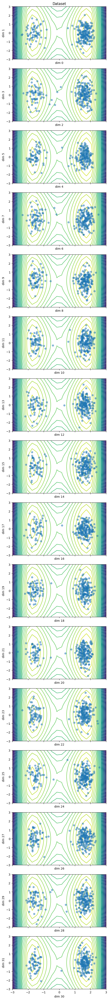

In [43]:
for i in range(0, 500, 49):
    plot_dataset(unnormalize(samples[i], global_mins_init, global_maxs_init))

### Training

In [44]:
def reward_matching_loss_biased(vectorfield, x, t, beta):     
    t = t.unsqueeze(1)
    h_t = beta * t
    # pdb.set_trace()?
    x.requires_grad = True

    # noisy sample: x(t)
    noisy_x = torch.normal(x, h_t ** 0.5)
    pred_scores = vectorfield(noisy_x, t.squeeze())

    estimated_scores = estimate_grad_Rt(noisy_x, t.squeeze(), beta)
    return ((estimated_scores - pred_scores)**2).mean()

In [45]:
beta = 1.1
vectorfield = MyMLP6dim().to(device)
opt_vectorfield = Adam(vectorfield.parameters(), lr=1e-4)

In [46]:
buffer = SimpleBuffer(dim, 10000, 1000, initial_sampler=None, 
                      device=device, fill_buffer_during_init=False, sample_with_replacement=True)

buffer.add(init_samples, init_energy)

Buffer not initialised, expected that checkpoint will be loaded.


RuntimeError: shape mismatch: value tensor of shape [256, 32] cannot be broadcast to indexing result of shape [256, 6]

  0%|          | 0/100 [00:00<?, ?it/s]

Epoch 0 | Loss 163.158661


Epoch 49 | Loss 439.144257
Epoch 98 | Loss 123.229416


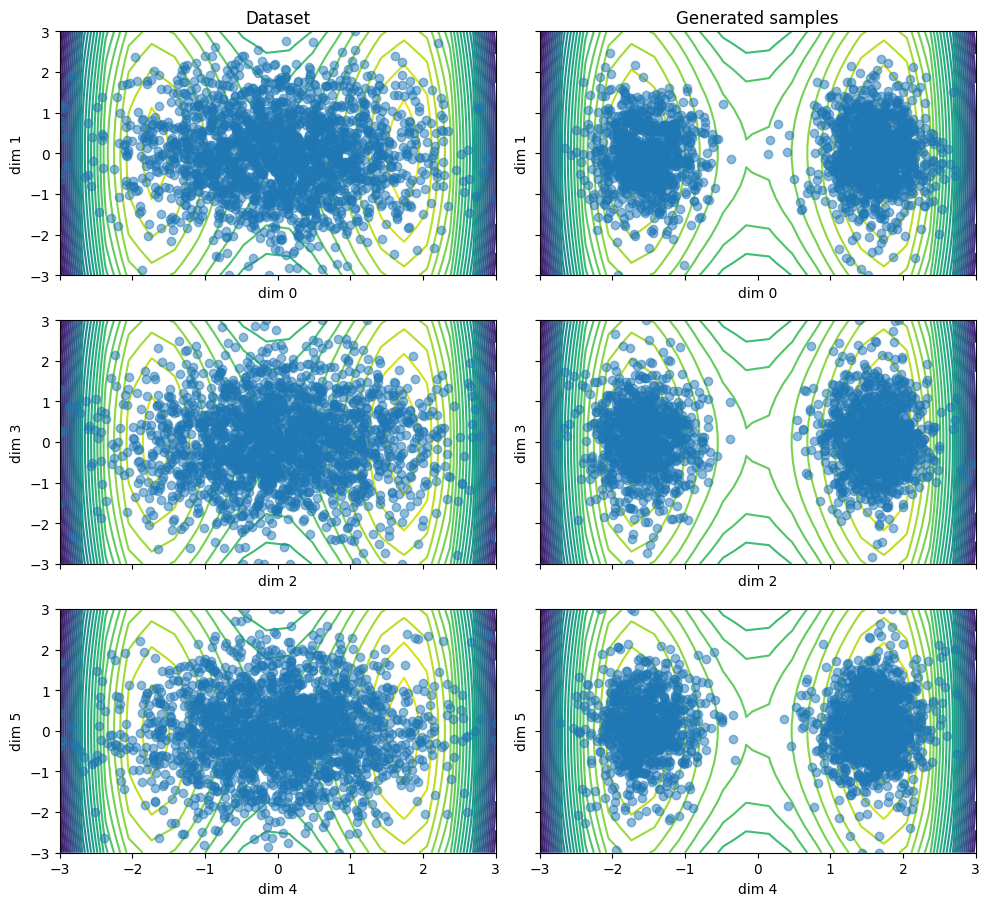

  1%|          | 1/100 [00:27<46:01, 27.90s/it]

Epoch 0 | Loss 1036.717651
Epoch 49 | Loss 376.824097


  1%|          | 1/100 [00:37<1:01:48, 37.46s/it]


KeyboardInterrupt: 

In [23]:
outer_epochs= 100
inner_epochs = 100

num_samples = 2048 

train_dataset = TensorDataset(init_samples.clone(), init_energy.clone())
trainloader = DataLoader(train_dataset, batch_size = 512, shuffle=True) 
global_mins, global_maxs = global_mins_init, global_maxs_init


for epoch in tqdm(range(outer_epochs)):
    for epoch in range(inner_epochs):
        total_loss = 0.
        for samples,_ in trainloader:
            samples = samples.to(device)
            opt_vectorfield.zero_grad()
            # t = torch.rand(len(samples), device=device)

            low_time_t = (-0.1 * torch.rand(len(samples), device=device)) + 0.1
            high_time_t = (-0.9 * torch.rand(len(samples), device=device)) + 1.0
            
            mask = torch.rand(len(samples), device=device) < 0.8
            
            t = (low_time_t * mask) + (high_time_t * ~mask)

            loss = reward_matching_loss_biased(vectorfield, samples, t, beta)
            total_loss += loss.item()
            loss.backward()
            opt_vectorfield.step()
        if epoch % 49 == 0:
            print("Epoch %d | Loss %f" % (epoch, loss.item()))


    # Generate samples using the vector field
    ve_reverse_sde = VEReverseSDE(vectorfield, beta)
    samples = generate_samples(ve_reverse_sde, init_samples)[-1]
    samples_energy = target.log_prob(unnormalize(samples, global_mins, global_maxs)).detach()

    # Update Buffer 
    buffer.add(samples, samples_energy)

    plot_dataset(unnormalize(train_dataset.tensors[0], global_mins, global_maxs), 
                 unnormalize(samples, global_mins, global_maxs))
    plt.show()
    # Resample data from the buffer
    samples, samples_energy, _ = buffer.sample(512 * 10)
    train_dataset = TensorDataset(samples, samples_energy)
    trainloader = DataLoader(train_dataset, batch_size = 512, shuffle=True)